## <font style="color:rgb(50,120,229)">Contrast Limited Adaptive Histogram Equalization (CLAHE) </font>

Histogram equalization uses the pixels of the entire image to improve contrast. While this may look good in many cases, sometimes we may want to enhance the contrast locally so the image does not looks more natural and less dramatic. 

For such applications, we use [Contrast Limited Adaptive Histogram Equalization (CLAHE)](https://docs.opencv.org/4.1.0/d5/daf/tutorial_py_histogram_equalization.html) ) which improves the local contrast. More importantly it allows us to specify the size of the neighborhood that is considered "local".  

Let's pick a different image, where we may prefer CLAHE in place of regular histogram equalization. 

In [1]:
import cv2
import matplotlib.pyplot as plt
DATA_PATH = './data/'
import numpy as np
%matplotlib inline

In [2]:
import matplotlib
matplotlib.rcParams['figure.figsize'] = (50.0, 50.0)
matplotlib.rcParams['image.cmap'] = 'gray'
matplotlib.rcParams['axes.titlesize'] = 40
matplotlib.rcParams['image.interpolation'] = 'bilinear'

(-0.5, 666.5, 999.5, -0.5)

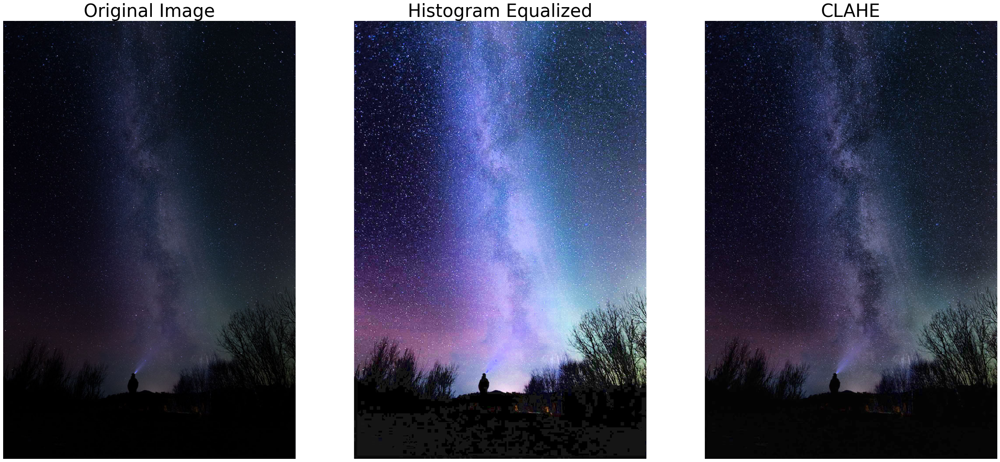

In [3]:
# Read color image
filename = DATA_PATH+"images/night-sky.jpg"
im = cv2.imread(filename)

# Convert to HSV 
imhsv = cv2.cvtColor(im, cv2.COLOR_BGR2HSV)
imhsvCLAHE = imhsv.copy()

# Perform histogram equalization only on the V channel
imhsv[:,:,2] = cv2.equalizeHist(imhsv[:,:,2])

clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
imhsvCLAHE[:,:,2] = clahe.apply(imhsvCLAHE[:,:,2])

# Convert back to BGR format
imEq = cv2.cvtColor(imhsv, cv2.COLOR_HSV2BGR)
imEqCLAHE = cv2.cvtColor(imhsvCLAHE, cv2.COLOR_HSV2BGR)


#Display images
plt.figure(figsize=(40,40))

ax = plt.subplot(1,3,1)
plt.imshow(im[:,:,::-1], vmin=0, vmax=255)
ax.set_title("Original Image")
ax.axis('off')


ax = plt.subplot(1,3,2)
plt.imshow(imEq[:,:,::-1], vmin=0, vmax=255)
ax.set_title("Histogram Equalized")
ax.axis('off')

ax = plt.subplot(1,3,3)
plt.imshow(imEqCLAHE[:,:,::-1], vmin=0, vmax=255)
ax.set_title("CLAHE")
ax.axis('off')

From the above figure, it is clear that CLAHE performs stretching of values locally since all the peaks in the original histogram have died down. The final image is much more faithful to the original intent of the photographer. 

In [4]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

<IPython.core.display.Javascript object>

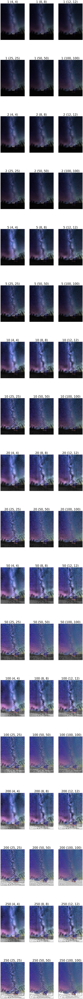

In [5]:
# Read color image
filename = DATA_PATH+"images/night-sky.jpg"
im = cv2.imread(filename)

# Convert to HSV 
imhsv = cv2.cvtColor(im, cv2.COLOR_BGR2HSV)


plt.figure(figsize=(20,250))

clipLimit = [1, 2, 5, 10, 20, 50, 100, 200, 250]
tileGridSize = [(4, 4), (8, 8), (12, 12), (25, 25), (50, 50), (100, 100)]

n = len(clipLimit)*len(tileGridSize)
n_cols = 3
n_rows = n//3
c = 1

for cl in clipLimit:
    for tgs in tileGridSize:
        
        imhsvCLAHE = imhsv.copy()
        
        clahe = cv2.createCLAHE(clipLimit=cl, tileGridSize=tgs)
        imhsvCLAHE[:,:,2] = clahe.apply(imhsvCLAHE[:,:,2])
        
        # Convert back to BGR format
        imEqCLAHE = cv2.cvtColor(imhsvCLAHE, cv2.COLOR_HSV2BGR)
        
        ax = plt.subplot(n_rows,n_cols,c)
        plt.imshow(imEqCLAHE[:,:,::-1], vmin=0, vmax=255)
        ax.set_title(str(cl)+' '+str(tgs))
        ax.axis('off')

        
        c+=1

In [6]:
import cv2
import os
import numpy as np
# from dataPath import DATA_PATH

imagePath = os.path.join(DATA_PATH, 'images/night-sky.jpg')
image = cv2.imread(imagePath, cv2.IMREAD_UNCHANGED)

kSize = 1.1
dsize = (int(image.shape[1] / kSize), int(image.shape[0] / kSize))

minClipLimit = 1
maxClipLimit = 1000

minTilleSize = 1
maxTilleSize = 100

origWindow = "Original"
claheWindow = "CLAHE"
heWindow = "Histogram Equalization"

trackbarClip = "Clip Limit (1.0 - 10.0)\n"
trackbarTileSize = "Tile Grid Size (1 - 100)"

def handleClip(pos, *args):
    tileSize = cv2.getTrackbarPos(trackbarTileSize, origWindow)
    if pos < minClipLimit:
        cv2.setTrackbarPos(trackbarClip, origWindow, minClipLimit)
        return
    render(pos, tileSize)

def handleTileSize(pos, *args):
    clipValue = cv2.getTrackbarPos(trackbarClip, origWindow)
    if pos < minTilleSize:
        cv2.setTrackbarPos(trackbarTileSize, origWindow, minTilleSize)
        return
    render(clipValue, pos)

def render(clipValue, tileSize):
    imhsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    clahe = cv2.createCLAHE(clipLimit = clipValue / 100, tileGridSize = (tileSize, tileSize))
    imhsv[:, :, 2] = clahe.apply(imhsv[:, :, 2])
    imEqCLAHE = cv2.cvtColor(imhsv, cv2.COLOR_HSV2BGR)
    cv2.imshow(claheWindow, cv2.resize(imEqCLAHE, dsize = dsize, interpolation = cv2.INTER_LINEAR))
    renderHist(imhsv)

def renderHist(imhsv):
    scale = 2
    h = np.zeros((257 * scale, 256 * scale))
    bins = np.arange(256 * scale).reshape(256 * scale, 1)
    histogram = cv2.calcHist([imhsv], [2], None, [256 * scale], [0, 256])
    cv2.normalize(histogram, histogram, 0, 256 * scale - 1, cv2.NORM_MINMAX)
    pts = np.int32(np.around(np.column_stack((bins, histogram))))
    cv2.polylines(h, [pts], False, (255, 255, 255))
    cv2.imshow(claheWindow + " - Histogram", np.flipud(h))

# original image with trackbars
cv2.namedWindow(origWindow, cv2.WINDOW_AUTOSIZE)
cv2.createTrackbar(trackbarClip, origWindow, minClipLimit, maxClipLimit, handleClip)
cv2.createTrackbar(trackbarTileSize, origWindow, minTilleSize, maxTilleSize, handleTileSize)
cv2.imshow(origWindow, cv2.resize(image, dsize = dsize, interpolation = cv2.INTER_LINEAR))

# initial CLAHE 
render(minClipLimit, minTilleSize)

# simple HE
imhsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
imhsv[:, :, 2] = cv2.equalizeHist(imhsv[:, :, 2])
imEq = cv2.cvtColor(imhsv, cv2.COLOR_HSV2BGR)
cv2.imshow(heWindow, cv2.resize(imEq, dsize = dsize, interpolation = cv2.INTER_LINEAR))

cv2.waitKey(0)
cv2.destroyAllWindows()

2
7
9
11
13
20
22
24
27
31
36
38
42
45
47
49
51
53
56
58
60
62
65
67
69
73
76
78
80
82
85
89
91
94
96
98
100
102
105
102
98
94
91
89
85
82
80
78
76
71
69
67
65
60
58
53
49
42
38
33
27
22
18
13
9
4
0
1
2
4
7
9
13
16
18
20
22
20
16
11
7
2
0
1
